Loading the Dataset

In [1]:
import pandas as pd
import csv

# Load the dataset
data = pd.read_csv('Reviews.csv')

# Display basic information about the dataset
print(data.info())

# Display the first few rows of the "Text" column to understand what kind of data we're dealing with
print(data['Text'].head())

data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568428 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB
None
0    I have bought several of the Vitality canned d...
1    Product arrived labeled as Jumbo Salted Peanut...
2    This is a confection that has been around a fe...
3    If you are looking for the 

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


Preprocessing the Datset

Removing HTML tages, converting to lowercase, tokenize text and Removing special characters.

In [2]:
import re
import pandas as pd
import nltk
from nltk.tokenize import word_tokenize


nltk.download('punkt')

def clean_and_tokenize_to_string(text):

    text = re.sub(r'<.*?>', '', text)

    text = text.lower().strip()

    tokens = word_tokenize(text)

    tokens = [re.sub(r'[^a-zA-Z\s]', '', token) for token in tokens]
  
    tokens = [token for token in tokens if token]

    cleaned_text = ' '.join(tokens)
    return cleaned_text


data['clean_text'] = data['Text'].apply(clean_and_tokenize_to_string)

print(data['clean_text'].head())


[nltk_data] Error loading punkt: <urlopen error [SSL:
[nltk_data]     CERTIFICATE_VERIFY_FAILED] certificate verify failed:
[nltk_data]     unable to get local issuer certificate (_ssl.c:1000)>


0    i have bought several of the vitality canned d...
1    product arrived labeled as jumbo salted peanut...
2    this is a confection that has been around a fe...
3    if you are looking for the secret ingredient i...
4    great taffy at a great price there was a wide ...
Name: clean_text, dtype: object


Removing Stop words 

In [3]:
import nltk
from nltk.corpus import stopwords

nltk.download('stopwords')


def remove_stopwords(text):
    stop_words = set(stopwords.words('english'))
    words = text.split()
    filtered_words = [word for word in words if word not in stop_words]
    return ' '.join(filtered_words)

data['no_stopwords'] = data['clean_text'].apply(remove_stopwords)

print(data['no_stopwords'].head())

[nltk_data] Error loading stopwords: <urlopen error [SSL:
[nltk_data]     CERTIFICATE_VERIFY_FAILED] certificate verify failed:
[nltk_data]     unable to get local issuer certificate (_ssl.c:1000)>


0    bought several vitality canned dog food produc...
1    product arrived labeled jumbo salted peanuts p...
2    confection around centuries light pillowy citr...
3    looking secret ingredient robitussin believe f...
4    great taffy great price wide assortment yummy ...
Name: no_stopwords, dtype: object


Stemming

In [4]:
from nltk.stem import PorterStemmer
import nltk

stemmer = PorterStemmer()

def stem_text(text):
    words = text.split()
    stemmed_words = [stemmer.stem(word) for word in words]
    return ' '.join(stemmed_words)

data['stemmed_text'] = data['no_stopwords'].apply(stem_text)

print(data['stemmed_text'].head())

0    bought sever vital can dog food product found ...
1    product arriv label jumbo salt peanut peanut a...
2    confect around centuri light pillowi citru gel...
3    look secret ingredi robitussin believ found go...
4    great taffi great price wide assort yummi taff...
Name: stemmed_text, dtype: object


Displaying first 5 Rows after preprocessing

In [5]:
data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,clean_text,no_stopwords,stemmed_text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,i have bought several of the vitality canned d...,bought several vitality canned dog food produc...,bought sever vital can dog food product found ...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled as jumbo salted peanut...,product arrived labeled jumbo salted peanuts p...,product arriv label jumbo salt peanut peanut a...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,this is a confection that has been around a fe...,confection around centuries light pillowy citr...,confect around centuri light pillowi citru gel...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,if you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,look secret ingredi robitussin believ found go...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,great taffy at a great price there was a wide ...,great taffy great price wide assortment yummy ...,great taffi great price wide assort yummi taff...


Splitting the Dataset and Apply Vectorization.

In [6]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
import pandas as pd

data['Sentiment'] = data['Score'].apply(lambda x: 1 if x > 3 else 0)


X_train, X_test, y_train, y_test = train_test_split(data['stemmed_text'], data['Sentiment'], test_size=0.2, random_state=42)

vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1, 2))  
X_train_tfidf = vectorizer.fit_transform(X_train)
X_test_tfidf = vectorizer.transform(X_test)
data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,clean_text,no_stopwords,stemmed_text,Sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,i have bought several of the vitality canned d...,bought several vitality canned dog food produc...,bought sever vital can dog food product found ...,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled as jumbo salted peanut...,product arrived labeled jumbo salted peanuts p...,product arriv label jumbo salt peanut peanut a...,0
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,this is a confection that has been around a fe...,confection around centuries light pillowy citr...,confect around centuri light pillowi citru gel...,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,if you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,look secret ingredi robitussin believ found go...,0
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,great taffy at a great price there was a wide ...,great taffy great price wide assortment yummy ...,great taffi great price wide assort yummi taff...,1


Performing SVM model

In [7]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

from sklearn.linear_model import SGDClassifier

svm_model = make_pipeline(StandardScaler(with_mean=False), SGDClassifier(loss='hinge'))

svm_model.fit(X_train_tfidf, y_train)

y_pred = svm_model.predict(X_test_tfidf)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy of the SVM model: {accuracy}')




Accuracy of the SVM model: 0.8812131127353968


Classification Report

1. Accuray 
2. precision 
3. Recall 
4. F1-score 
5. Confusion matrix 

In [8]:

report = classification_report(y_test, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.77      0.64      0.70     24666
           1       0.90      0.95      0.93     89025

    accuracy                           0.88    113691
   macro avg       0.84      0.79      0.81    113691
weighted avg       0.88      0.88      0.88    113691



Confusion Matrix

In [9]:

cm = confusion_matrix(y_test, y_pred)
print(cm)

[[15741  8925]
 [ 4580 84445]]


Predicting one review

In [10]:
def predict_sentiment_svm(review):
    # Clean and preprocess the review if not already done
    review_cleaned = clean_and_tokenize_to_string(review)  # Ensure this function is properly defined to match your preprocessing
    review_vectorized = vectorizer.transform([review_cleaned])
    prediction = svm_model.predict(review_vectorized)
    return 'Positive' if prediction[0] == 1 else 'Negative'

# Example usage
new_review = "This product was great! Very helpful and works perfectly."
print(predict_sentiment_svm(new_review))


Positive


For the model evaluation we are using different metrics like 


6. ROC curve 
7. AUC-PR curve  

Confusion Metrics Plot

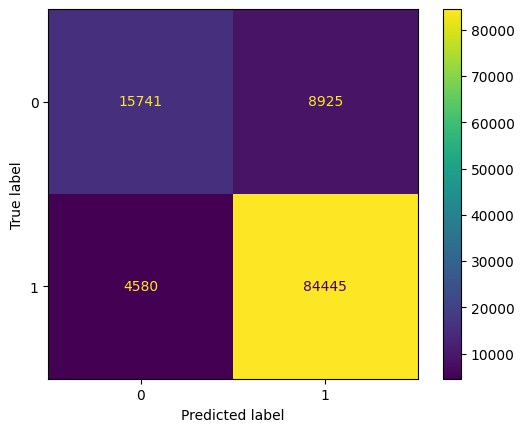

In [11]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Display the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

ROC Curve

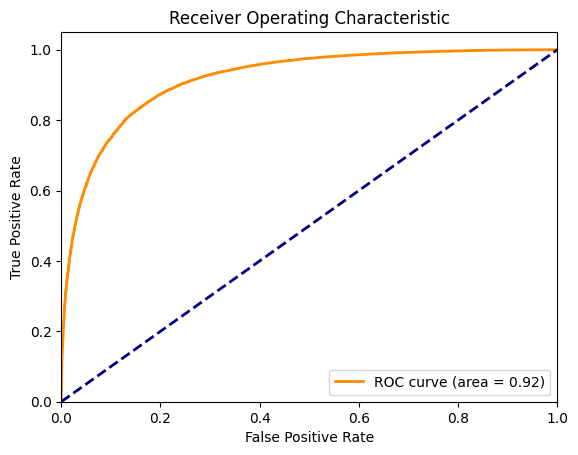

In [12]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

y_scores = svm_model.decision_function(X_test_tfidf)

fpr, tpr, _ = roc_curve(y_test, y_scores)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()


ROC-PR curve

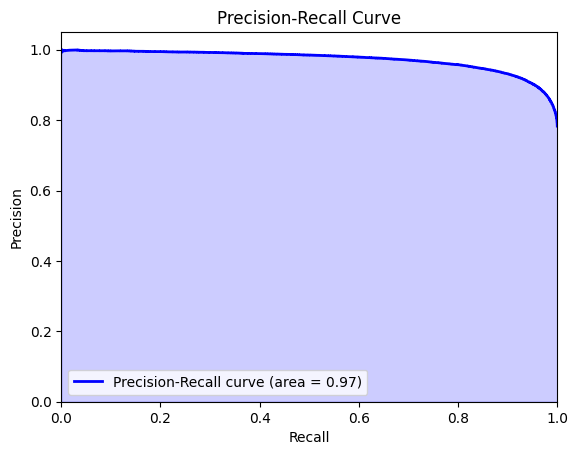

In [13]:
from sklearn.metrics import precision_recall_curve, auc

precision, recall, _ = precision_recall_curve(y_test, y_scores)
auc_pr = auc(recall, precision)

plt.figure()
plt.plot(recall, precision, color='blue', lw=2, label='Precision-Recall curve (area = %0.2f)' % auc_pr)
plt.fill_between(recall, precision, alpha=0.2, color='blue')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="lower left")
plt.show()


Cross Validation

In [14]:
from sklearn.model_selection import cross_val_score

cross_val_scores = cross_val_score(svm_model, X_train_tfidf, y_train, cv=5, scoring='accuracy')

mean_cv_score = cross_val_scores.mean()
std_cv_score = cross_val_scores.std()

print(f"Mean cross-validation accuracy: {mean_cv_score:.4f}")
print(f"Standard deviation of cross-validation accuracy: {std_cv_score:.4f}")


Mean cross-validation accuracy: 0.8769
Standard deviation of cross-validation accuracy: 0.0013


Let's examine the two graphs you've posted:

1. **ROC Curve:**
   - This graph is a plot of the True Positive Rate (TPR) against the False Positive Rate (FPR) at various threshold settings.
   - The TPR is on the Y-axis, and the FPR is on the X-axis.
   - A higher area under the curve (AUC) indicates a better model performance. In this case, the AUC is 0.92, which suggests that the model has a good measure of separability. It means that the model does a good job distinguishing between the two classes.
   - The curve is significantly above the dashed line, which represents a random guess (AUC of 0.5). The further the curve lies above the dashed line, the better the model's predictive performance.
   - The curve tends toward the top left corner, which indicates a lower FPR for a given TPR, a desirable trait in a predictive model.

2. **Precision-Recall (PR) Curve:**
   - This graph shows the trade-off between precision and recall for different thresholds.
   - Precision is on the Y-axis, and recall is on the X-axis.
   - A higher area under the curve indicates better performance. The AUC for the PR curve is 0.97, which is considered excellent.
   - This model's PR curve suggests that it maintains a high precision even as recall increases, which is indicative of a model that returns more relevant results than irrelevant ones and does so consistently across different threshold settings.
   - The high area under the curve indicates that the model is able to retain high precision while recalling a large proportion of positive instances.

Overall, both curves indicate that your sentiment analysis model is performing well on the test data. The high AUC values suggest that the model is capable of differentiating between the classes with a high degree of accuracy. However, it is also essential to consider the context in which the model will be deployed, as real-world data can present challenges that are not always reflected in test metrics. Additionally, you should examine how the model performs across different segments of your data and consider other factors like model interpretability and computational efficiency.

Displaying Sentiment Scores

In [15]:
data["Sentiment"]

0         1
1         0
2         1
3         0
4         1
         ..
568449    1
568450    0
568451    1
568452    1
568453    1
Name: Sentiment, Length: 568454, dtype: int64

In [16]:
def probability_to_rating(prob_positive):
    return round(1 + 4 * prob_positive)

In [17]:
def map_sentiment_to_stars(prob_positive):
    if prob_positive > 0.9:
        return 5
    elif prob_positive > 0.75:
        return 4
    elif prob_positive > 0.55:
        return 3
    elif prob_positive > 0.3:
        return 2
    else:
        return 1

In [18]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import SGDClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import train_test_split


svm_pipeline = make_pipeline(StandardScaler(with_mean=False), SGDClassifier(loss='hinge'))

calibrated_clf = CalibratedClassifierCV(svm_pipeline, method='sigmoid', cv=5)

calibrated_clf.fit(X_train_tfidf, y_train)

y_prob = calibrated_clf.predict_proba(X_test_tfidf)
print("Predicted probabilities:\n", y_prob)

y_pred = calibrated_clf.predict(X_test_tfidf)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy of the SVM model: {accuracy}')

report = classification_report(y_test, y_pred)
print(report)

cm = confusion_matrix(y_test, y_pred)
print(cm)


Predicted probabilities:
 [[0.04831565 0.95168435]
 [0.12415279 0.87584721]
 [0.25026831 0.74973169]
 ...
 [0.13448723 0.86551277]
 [0.68347247 0.31652753]
 [0.03402835 0.96597165]]
Accuracy of the SVM model: 0.8868512019421062
              precision    recall  f1-score   support

           0       0.81      0.63      0.71     24666
           1       0.90      0.96      0.93     89025

    accuracy                           0.89    113691
   macro avg       0.86      0.79      0.82    113691
weighted avg       0.88      0.89      0.88    113691

[[15477  9189]
 [ 3675 85350]]


Predicting rating from 1 to 5 for text.

In [19]:

for i, probs in enumerate(y_prob):
    positive_prob = probs[1]
    star_rating = map_sentiment_to_stars(positive_prob)
    print(f"Review: {X_test.iloc[i]}")
    print(f"Star Rating: {star_rating} stars")
    print()

Review: tri coupl brand glutenfre sandwich cooki best bunch crunchi true textur real cooki nt glutenfre might think fill make bit sweet mean satisfi sweet tooth sooner chocol version glutino good true chocolatey tast someth nt glutenfre brand
Star Rating: 5 stars

Review: cat love treat ever ca nt find hous pop top bolt wherev hide come get treat nt like crunchi treat much perfect given three flavor seem like equal tend dri time near end bottl howev fliptop lid handi nice inexpens kitti treat yet meet cat nt love
Star Rating: 4 stars

Review: littl less expect tend muddi tast expect sinc said favorit compani
Star Rating: 3 stars

Review: first frost miniwheat origin size frost miniwheat bite size well reason much mouth frost miniwheat littl bit ye half size bite size version particular one cinnamon roll noth new tabl except size unnecessari person like origin flavor size best bite size edit accommod come desper attempt give attent brand need sort life put back came make smaller new fla

In [20]:

data_tfidf = vectorizer.transform(data['stemmed_text']) 
y_prob_all = calibrated_clf.predict_proba(data_tfidf)

data['Star Rating'] = [map_sentiment_to_stars(prob[1]) for prob in y_prob_all]

Displaying text and rating

In [21]:
print(data[['stemmed_text', 'Star Rating']])

                                             stemmed_text  Star Rating
0       bought sever vital can dog food product found ...            3
1       product arriv label jumbo salt peanut peanut a...            2
2       confect around centuri light pillowi citru gel...            5
3       look secret ingredi robitussin believ found go...            4
4       great taffi great price wide assort yummi taff...            5
...                                                   ...          ...
568449  great sesam chicken good better restur eaten h...            5
568450  disappoint flavor chocol note especi weak milk...            1
568451  star small give one train session tri train do...            4
568452  best treat train reward dog good groom lower c...            5
568453  satisfi product advertis use cereal raw vinega...            4

[568454 rows x 2 columns]


Plotting Rating vs reviews.

In [22]:
# Save DataFrame to CSV
data.to_csv('data.csv', index=False)  # Set index=False to exclude the index from the CSV file



/var/folders/ly/ymgpnm5s1ys7l3rw4mpr60n40000gn/T/ipykernel_2616/1717137665.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Star Rating', data=data, palette='viridis')


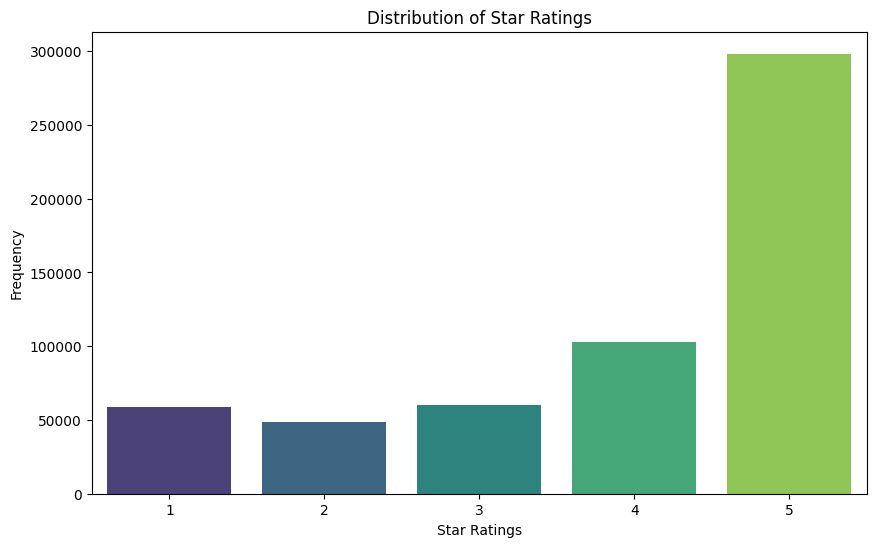

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))

sns.countplot(x='Star Rating', data=data, palette='viridis') 

plt.title('Distribution of Star Ratings')
plt.xlabel('Star Ratings')
plt.ylabel('Frequency')


plt.show()